# NVIDIA TAO DetectNet_v2 for Infineon PSOC EDGE Devices

Welcome to this comprehensive guide on training and optimizing neural networks for deployment on Infineon PSOC EDGE devices using NVIDIA's Train Adapt Optimize (TAO) Toolkit. This notebook will walk you through the complete workflow from training a custom object detection model to optimizing it for efficient deployment on resource-constrained edge devices.

## What is TAO Toolkit?

Transfer learning is the process of transferring learned features from one application to another. It is a commonly used training technique where you use a model trained on one task and re-train to use it on a different task. 

Train Adapt Optimize (TAO) Toolkit is a simple and easy-to-use Python based AI toolkit for taking purpose-built AI models and customizing them with users' own data. The TAO Toolkit provides a streamlined workflow to:

1. **Train**: Fine-tune pre-trained models with your own data
2. **Adapt**: Adapt models to your specific use-case
3. **Optimize**: Optimize models for efficient deployment on edge devices

<img align="center" src="https://d29g4g2dyqv443.cloudfront.net/sites/default/files/akamai/TAO/tlt-tao-toolkit-bring-your-own-model-diagram.png" width="1080">

## What is DetectNet-V2?

DetectNet_v2, also known as GridBox object detection, is a highly optimized CNN-based object detection model designed for efficient inference. It works by:

1. Dividing an input image into a uniform grid
2. Predicting four normalized bounding-box parameters (xc, yc, w, h) and confidence value per output class for each grid cell
3. Post-processing detections using clustering algorithms such as DBSCAN, NMS, or HYBRID (DBSCAN + NMS)

DetectNet_v2 is particularly well-suited for resource-constrained environments like the Infineon PSOC EDGE devices due to its computational efficiency while maintaining high accuracy.

### Sample output predictions from a trained DetectNet_v2 model

<img align="center" src="https://miro.medium.com/v2/resize:fit:720/0*YaQDIKR4gRbP2-by" width="960">

<img align="center" src="https://miro.medium.com/v2/resize:fit:720/0*eY1qluSyldYl9qDw" width="960">

## Workflow Overview and Learning Objectives

This notebook demonstrates how to leverage NVIDIA TAO to train and optimize a DetectNet_v2 model for deployment on Infineon PSOC EDGE devices. You will learn how to:

1. **Environment Setup**: Configure your environment for TAO toolkit
2. **Data Preparation**: Prepare your dataset in the required format for training
3. **Model Training**: Train a ResNet-18 based DetectNet_v2 model on the COCO dataset
4. **Model Evaluation**: Evaluate the trained model's performance
5. **Model Pruning**: Optimize the model size by pruning unnecessary weights
6. **Model Retraining**: Recover accuracy after pruning through retraining
7. **Quantization-Aware Training (QAT)**: Further optimize the model for deployment on edge devices
8. **Model Export**: Export the optimized model to ONNX format for deployment
9. **Infineon Toolchain Integration**: Convert the model for Infineon PSOC EDGE devices

By the end of this notebook, you will have a trained, pruned, quantized, and deployment-ready object detection model optimized for Infineon PSOC EDGE devices.

## 1. Environment Setup

Let's begin by setting up our environment variables and configuring the workspace. These variables will be used throughout the notebook to reference directories and files.

### 1.1 Setting Environment Variables

The following cell sets up environment variables that define:
- The number of GPUs to use for training
- Directory paths for experiments, data, and specifications

**Note**: Please make sure to remove any stray artifacts/files from previous experiments in `$USER_EXPERIMENT_DIR` or `$DATA_DOWNLOAD_DIR` as they may interfere with creating a training graph for a new experiment.

In [1]:
# Setting up env variables for cleaner command line commands.
import os

%env NUM_GPUS=2
%env USER_EXPERIMENT_DIR=/workspace/tao-experiments/detectnet_v2
%env DATA_DOWNLOAD_DIR=/workspace/tao-experiments/data

# Set this path if you don't run the notebook from the samples directory.
# %env NOTEBOOK_ROOT=~/tao-samples/detectnet_v2

# Please define this local project directory that needs to be mapped to the TAO docker session.
# The dataset expected to be present in $LOCAL_PROJECT_DIR/data, while the results for the steps
# in this notebook will be stored at $LOCAL_PROJECT_DIR/detectnet_v2
# !PLEASE MAKE SURE TO UPDATE THIS PATH!.

os.environ["LOCAL_PROJECT_DIR"] = "/teamspace/studios/this_studio"

os.environ["LOCAL_DATA_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "data"
)
os.environ["LOCAL_EXPERIMENT_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "detectnet_v2"
)

# Make the experiment directory 
! mkdir -p $LOCAL_EXPERIMENT_DIR

# The sample spec files are present in the same path as the downloaded samples.
os.environ["LOCAL_SPECS_DIR"] = os.path.join(
    os.getenv("NOTEBOOK_ROOT", os.getcwd()),
    "specs"
)
%env SPECS_DIR=/workspace/tao-experiments/detectnet_v2/specs
CLEARML_LOGGED_IN = False
WANDB_LOGGED_IN = False

# Showing list of specification files.
!ls -rlt $LOCAL_SPECS_DIR

env: NUM_GPUS=2
env: USER_EXPERIMENT_DIR=/workspace/tao-experiments/detectnet_v2
env: DATA_DOWNLOAD_DIR=/workspace/tao-experiments/data


env: SPECS_DIR=/workspace/tao-experiments/detectnet_v2/specs
total 28
-rwxr--r-- 1 nialllyons nialllyons 2752 Feb 19 03:02 download_coco.sh
-rwxr--r-- 1 nialllyons nialllyons  331 Feb 19 03:46 detectnet_v2_tfrecords_coco_trainval.txt
-rwxr--r-- 1 nialllyons nialllyons   65 Feb 19 04:14 check_data.sh
-rwxr--r-- 1 nialllyons nialllyons 3442 Feb 19 04:31 detectnet_v2_train_resnet18_coco.txt
-rwxr--r-- 1 nialllyons nialllyons 3414 Feb 19 07:21 detectnet_v2_retrain_resnet18_coco_qat.txt
-rwxr--r-- 1 nialllyons nialllyons 3431 Feb 19 07:21 detectnet_v2_retrain_resnet18_coco.txt
-rwxr--r-- 1 nialllyons nialllyons 1441 Feb 19 19:23 detectnet_v2_inference_coco.txt


### 1.2 Mapping Directories to TAO Docker

The following cell maps our local directories to the TAO docker container. This allows TAO to access our data and save the results properly.

The mapping includes:
- The data directory containing our dataset
- The specs directory containing configuration files
- The experiment directory where outputs will be stored

This step is crucial for ensuring proper data access and result persistence between your local filesystem and the TAO docker environment.

In [2]:
# Mapping up the local directories to the TAO docker.
import json
mounts_file = os.path.expanduser("~/.tao_mounts.json")

# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
        # Mapping the data directory
        {
            "source": os.environ["LOCAL_PROJECT_DIR"],
            "destination": "/workspace/tao-experiments"
        },
        # Mapping the specs directory.
        {
            "source": os.environ["LOCAL_SPECS_DIR"],
            "destination": os.environ["SPECS_DIR"]
        },
        {
            "source": "/teamspace/studios/this_studio/data",
            "destination": "/workspace/tao-experiments/data"
        }
    ],
    "DockerOptions":{
        "user": f"{os.getuid()}:{os.getgid()}"
    }
}

if CLEARML_LOGGED_IN:
    if "Envs" not in drive_map.keys():
        drive_map["Envs"] = []
    drive_map["Envs"].extend([
        {
            "variable": "CLEARML_WEB_HOST",
            "value": os.getenv("CLEARML_WEB_HOST")
        },
        {
            "variable": "CLEARML_API_HOST",
            "value": os.getenv("CLEARML_API_HOST")
        },
        {
            "variable": "CLEARML_FILES_HOST",
            "value": os.getenv("CLEARML_FILES_HOST")
        },
        {
            "variable": "CLEARML_API_ACCESS_KEY",
            "value": os.getenv("CLEARML_API_ACCESS_KEY")
        },
        {
            "variable": "CLEARML_API_SECRET_KEY",
            "value": os.getenv("CLEARML_API_SECRET_KEY")
        },
    ])

if WANDB_LOGGED_IN:
    if "Envs" not in drive_map.keys():
        drive_map["Envs"] = []
    # Weights and biases currently requires access to the
    # /.config directory in the docker. Therefore, the docker
    # must be instantiated as root user. With the cells mentioned below
    # we will be deleting the cells that set user roles.
    if "user" in drive_map["DockerOptions"].keys():
        del(drive_map["DockerOptions"]["user"])
    drive_map["Envs"].extend([
        {
            "variable": "WANDB_API_KEY",
            "value": os.getenv("WANDB_API_KEY")
        }
    ])

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)


In [3]:
!cat ~/.tao_mounts.json

{
    "Mounts": [
        {
            "source": "/teamspace/studios/this_studio",
            "destination": "/workspace/tao-experiments"
        },
        {
            "source": "/teamspace/studios/this_studio/specs",
            "destination": "/workspace/tao-experiments/detectnet_v2/specs"
        },
        {
            "source": "/teamspace/studios/this_studio/data",
            "destination": "/workspace/tao-experiments/data"
        }
    ],
    "DockerOptions": {
        "user": "1000:1000"
    }
}

### 1.3 Installing the TAO Launcher

The TAO launcher is a Python package that provides the interface to the TAO toolkit. It's distributed as a Python wheel on PyPI and can be installed with pip.

**Prerequisites**:
- Python >=3.7, <=3.10.x
- docker-ce > 19.03.5
- docker-API 1.40
- nvidia-container-toolkit > 1.3.0-1
- nvidia-container-runtime > 3.4.0-1
- nvidia-docker2 > 2.5.0-1
- nvidia-driver > 455+

After installation, we verify the TAO launcher version to ensure everything is set up correctly.

In [5]:
# SKIP this step IF you have already installed the TAO launcher wheel.
!pip3 install nvidia-tao

  Attempting uninstall: urllib3
    Found existing installation: urllib3 2.3.0
    Uninstalling urllib3-2.3.0:
      Successfully uninstalled urllib3-2.3.0
  Attempting uninstall: six
    Found existing installation: six 1.17.0
    Uninstalling six-1.17.0:
      Successfully uninstalled six-1.17.0
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
  Attempting uninstall: websocket-client
    Found existing installation: websocket-client 1.8.0
    Uninstalling websocket-client-1.8.0:
      Successfully uninstalled websocket-client-1.8.0
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Uninstalling requests-2.32.3:
      Successfully uninstalled requests-2.32.3
  Attempting uninstall: docker
    Found existing installation: docker 7.1.0
    Uninstalling docker-7.1.0:
      Successfully uninstalled docker-7.1.0
ERROR: pip's dependency resolver does not currently t

In [6]:
# View the versions of the TAO launcher
!tao info --verbose

Configuration of the TAO Toolkit Instance

task_group:         
    model:             
        dockers:                 
            nvidia/tao/tao-toolkit:                     
                5.5.0-pyt:                         
                    docker_registry: nvcr.io
                    tasks: 
                        1. action_recognition
                        2. centerpose
                        3. visual_changenet
                        4. deformable_detr
                        5. dino
                        6. grounding_dino
                        7. mask_grounding_dino
                        8. mask2former
                        9. mal
                        10. ml_recog
                        11. ocdnet
                        12. ocrnet
                        13. optical_inspection
                        14. pointpillars
                        15. pose_classification
                        16. re_identification
                        17. classification_py

## 2. Prepare dataset and pre-trained model <a class="anchor" id="head-2"></a>

## 2. Data Preparation

In this section, we'll prepare the COCO dataset for training our object detection model. The dataset must be properly structured and converted to TFRecords format for efficient training.

### 2.1 Downloading the Dataset

We'll download the COCO dataset, which contains images and annotations for common objects in context. This dataset is widely used for object detection tasks and provides a good baseline for training models that can later be fine-tuned for specific applications.

In [7]:
# Create local dir
!mkdir -p $LOCAL_DATA_DIR
!mkdir -p $LOCAL_EXPERIMENT_DIR
# Download and preprocess data
!tao model detectnet_v2 run bash $SPECS_DIR/download_coco.sh $DATA_DOWNLOAD_DIR

2025-02-19 03:35:28,968 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 03:35:29,026 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 03:35:29,027 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 322: The required docker doesn't exist locally/the manifest has changed. Pulling a new docker.
2025-02-19 03:35:29,027 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 173: Pulling the required container. This may take several minutes if you're doing this for the first time. Please wait here.
...
Pulling from repository: nvcr.io/nvidia/tao/tao-toolkit
[Download 7608715873ec] ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--
[Download 7608715873ec] ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--
[Download bc615fe751be] ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--
[Download 7608715873ec

### 2.2 Verifying the Downloaded Dataset

Let's verify that our dataset has been correctly downloaded by checking the number of training images, labels, and testing images. This step ensures we have all the necessary data before proceeding to model training.

In [ ]:
# verify
import os

DATA_DIR = os.environ.get('LOCAL_DATA_DIR')
num_training_images = len(os.listdir(os.path.join(DATA_DIR, "training/image_2")))
num_training_labels = len(os.listdir(os.path.join(DATA_DIR, "training/label_2")))
num_testing_images = len(os.listdir(os.path.join(DATA_DIR, "testing/image_2")))
print("Number of images in the train/val set. {}".format(num_training_images))
print("Number of labels in the train/val set. {}".format(num_training_labels))
print("Number of images in the test set. {}".format(num_testing_images))

### 2.3 Converting Dataset to TFRecords

For efficient training with NVIDIA TAO, we need to convert our dataset to TFRecords format. TFRecords is the native file format for TensorFlow, optimized for handling large datasets and enabling faster data loading during training.

The following steps involve:
1. Reviewing the TFRecords conversion specification file
2. Creating a directory for storing the TFRecords
3. Running the conversion process
4. Verifying the generated TFRecords

In [18]:
print("TFrecords conversion spec file for kitti training")
!cat $LOCAL_SPECS_DIR/detectnet_v2_tfrecords_coco_trainval.txt

TFrecords conversion spec file for kitti training
coco_config {
  root_directory_path: "/workspace/tao-experiments/data/raw-data"
  img_dir_names: ["val2017", "train2017"]
  annotation_files: ["annotations/instances_val2017.json", "annotations/instances_train2017.json"]
  num_partitions: 2
  num_shards: [32, 256]
}
image_directory_path: "/workspace/tao-experiments/data/raw-data"

In [12]:
# Creating a new directory for the output tfrecords dump.
print("Converting Tfrecords for kitti trainval dataset")
!mkdir -p $LOCAL_DATA_DIR/tfrecords
!tao model detectnet_v2 dataset_convert \
                  -d $SPECS_DIR/detectnet_v2_tfrecords_coco_trainval.txt \
                  -o $DATA_DOWNLOAD_DIR/tfrecords/coco_trainval/coco_trainval \
                  -r $USER_EXPERIMENT_DIR/

Converting Tfrecords for kitti trainval dataset
2025-02-19 03:46:30,036 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 03:46:30,097 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 03:46:30,105 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 03:46:30.826269: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 03:46:30,865 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 03:46:32,104 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 03

In [4]:
!ls -rlt $LOCAL_DATA_DIR/tfrecords/coco_trainval/

total 120428
-rw-r--r-- 1 nialllyons nialllyons 158029 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00000-of-00032
-rw-r--r-- 1 nialllyons nialllyons 139151 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00001-of-00032
-rw-r--r-- 1 nialllyons nialllyons 156669 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00002-of-00032
-rw-r--r-- 1 nialllyons nialllyons 170366 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00003-of-00032
-rw-r--r-- 1 nialllyons nialllyons 167441 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00004-of-00032
-rw-r--r-- 1 nialllyons nialllyons 162811 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00005-of-00032
-rw-r--r-- 1 nialllyons nialllyons 161948 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00006-of-00032
-rw-r--r-- 1 nialllyons nialllyons 159294 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00007-of-00032
-rw-r--r-- 1 nialllyons nialllyons 155928 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00008-of-00032
-rw-r--r-- 1 nialllyons nialllyon

In [5]:
!tao model detectnet_v2 run bash $SPECS_DIR/check_data.sh

2025-02-19 04:20:33,565 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 04:20:33,628 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 04:20:33,636 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
total 120460
      174 drwxr-xr-x 2 1000 1000  28672 Feb 19 03:47 .
      173 drwxr-xr-x 3 1000 1000   4096 Feb 19 03:45 ..
135790595 -rw-r--r-- 1 1000 1000 158029 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00000-of-00032
135790596 -rw-r--r-- 1 1000 1000 139151 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00001-of-00032
135790597 -rw-r--r-- 1 1000 1000 156669 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00002-of-00032
135790598 -rw-r--r-- 1 1000 1000 170366 Feb 19 03:46 coco_trainval-fold-000-of-002-shard-00003-of-00032
135790599 -rw-r--r-- 1 1000 1000 167441 Feb 19 03:46 coco_trainval-fo

### 2.4 Downloading the Pre-trained Model

To leverage transfer learning, we'll download a pre-trained ResNet-18 model from NVIDIA's NGC registry. Using a pre-trained model significantly reduces training time and often leads to better performance, especially when training data is limited.

For DetectNet_v2, the input is expected to be 0-1 normalized with input channels in RGB order. Therefore, we use models from the `nvidia/tao/pretrained_detectnet_v2` repository which are specifically prepared for this purpose.

In [6]:
# Installing NGC CLI on the local machine.
## Download and install
%env CLI=ngccli_cat_linux.zip
!mkdir -p $LOCAL_PROJECT_DIR/ngccli

# Remove any previously existing CLI installations
!rm -rf $LOCAL_PROJECT_DIR/ngccli/*
!wget "https://ngc.nvidia.com/downloads/$CLI" -P $LOCAL_PROJECT_DIR/ngccli
!unzip -u "$LOCAL_PROJECT_DIR/ngccli/$CLI" -d $LOCAL_PROJECT_DIR/ngccli/
!rm $LOCAL_PROJECT_DIR/ngccli/*.zip 
os.environ["PATH"]="{}/ngccli/ngc-cli:{}".format(os.getenv("LOCAL_PROJECT_DIR", ""), os.getenv("PATH", ""))

env: CLI=ngccli_cat_linux.zip


--2025-02-19 04:20:45--  https://ngc.nvidia.com/downloads/ngccli_cat_linux.zip
Resolving ngc.nvidia.com (ngc.nvidia.com)... 18.165.83.111, 18.165.83.59, 18.165.83.119, ...
Connecting to ngc.nvidia.com (ngc.nvidia.com)|18.165.83.111|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48778122 (47M) [application/zip]
Saving to: ‘/teamspace/studios/this_studio/ngccli/ngccli_cat_linux.zip’

ngccli_cat_linux.zi 100%[===================>]  46.52M   193MB/s    in 0.2s    

2025-02-19 04:20:45 (193 MB/s) - ‘/teamspace/studios/this_studio/ngccli/ngccli_cat_linux.zip’ saved [48778122/48778122]

Archive:  /teamspace/studios/this_studio/ngccli/ngccli_cat_linux.zip
   creating: /teamspace/studios/this_studio/ngccli/ngc-cli/
   creating: /teamspace/studios/this_studio/ngccli/ngc-cli/googleapis_common_protos-1.66.0.dist-info/
  inflating: /teamspace/studios/this_studio/ngccli/ngc-cli/googleapis_common_protos-1.66.0.dist-info/METADATA  
 extracting: /teamspace/studios/this_studio

In [7]:
# List models available in the model registry.
!ngc registry model list nvidia/tao/pretrained_detectnet_v2:*

zsh:1: no matches found: nvidia/tao/pretrained_detectnet_v2:*


In [8]:
# Create the target destination to download the model.
!mkdir -p $LOCAL_EXPERIMENT_DIR/pretrained_resnet18/

In [9]:
# Download the pretrained model from NGC
!ngc registry model download-version nvidia/tao/pretrained_detectnet_v2:resnet18 \
    --dest $LOCAL_EXPERIMENT_DIR/pretrained_resnet18

Getting files to download...
⠙ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠹ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠼ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠴ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠦ ━━ • … • Remaining: 0… • … • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠇ ╸━ • … • Remaining: 0… • … • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠏ ━╺ • … • Remaining: 0… • … • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠋ ━╸ • … • Remaining: 0… • … • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
  ━━ • … • Remaining: 0… • … • Elapsed: 0… • Total: 1 - Completed: 1 - Failed: 0
       …                   …                                                    

--------------------------------------------------------------------------------
   Download status: COMPLETED
   Downloaded local path model: /teamspace/studio

In [10]:
!ls -rlt $LOCAL_EXPERIMENT_DIR/pretrained_resnet18/pretrained_detectnet_v2_vresnet18

total 91160
-rw-r--r-- 1 nialllyons nialllyons 93345248 Feb 19 04:20 resnet18.hdf5


## 3. Training Configuration

Now that we have our dataset and pre-trained model, we need to configure the training parameters. The training specification file defines various aspects of the training process, including:

- Dataset paths and configurations
- Pre-trained model path
- Augmentation parameters for data diversification
- Training hyperparameters (batch size, learning rate, epochs, etc.)
- Evaluation settings

Let's examine the training specification file to understand the configuration for our DetectNet_v2 model.

In [21]:
!cat $LOCAL_SPECS_DIR/detectnet_v2_train_resnet18_coco.txt

dataset_config {
  data_sources {
    tfrecords_path: "/workspace/tao-experiments/data/tfrecords/coco_trainval/coco_trainval-fold-001-of-002-shard-*-of-00256"
    image_directory_path: "/workspace/tao-experiments/data/raw-data"
  }
  image_extension: "jpg"
  target_class_mapping {
    key: "person"
    value: "person"
  }
  validation_data_source: {
    tfrecords_path: "/workspace/tao-experiments/data/tfrecords/coco_trainval/coco_trainval-fold-000-of-002-shard-*-of-00032"
    image_directory_path: "/workspace/tao-experiments/data/raw-data"
  }
}
augmentation_config {
  preprocessing {
    output_image_width: 320
    output_image_height: 240
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    enable_auto_resize: true
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  }
  color_augmentation {
    hue_rotation_max: 25.0
    saturation_shift_max: 0.20000000298
    contr

## 4. Model Training

With our environment set up, data prepared, and training configuration defined, we can now train our DetectNet_v2 model. This process will fine-tune the pre-trained ResNet-18 model on our specific dataset.

**Important Notes**:
- Training may take several hours to complete depending on your GPU configuration
- DetectNet_v2 supports restart from checkpoint if training is interrupted
- When using multiple GPUs, you may need to adjust batch size and learning rate accordingly

First, we'll ensure the experiment directory is clean by removing any previous training artifacts.

In [22]:
!rm -rf $USER_EXPERIMENT_DIR/experiment_dir_unpruned

### 4.1 Running the Training Process

Now we'll start the training process using the TAO toolkit. The command below:
1. Specifies the model type (detectnet_v2)
2. Provides the training specification file
3. Sets the output directory for the trained model
4. Names the model for easier reference
5. Specifies the number of GPUs to use

In [23]:
!tao model detectnet_v2 train -e $SPECS_DIR/detectnet_v2_train_resnet18_coco.txt \
                        -r $USER_EXPERIMENT_DIR/experiment_dir_unpruned \
                        -n resnet18_detector \
                        --gpus $NUM_GPUS

2025-02-19 04:31:46,874 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 04:31:46,937 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 04:31:46,946 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 04:31:47.713139: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 04:31:47,752 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 04:31:49,072 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 04:31:49,102 [TAO Toolkit] [WARNING] tensorflow 42

In [24]:
print('Model for each epoch:')
print('---------------------')
!ls -lh $LOCAL_EXPERIMENT_DIR/experiment_dir_unpruned/weights

Model for each epoch:
---------------------
total 86M
-rw-r--r-- 1 nialllyons nialllyons 86M Feb 19 10:36 resnet18_detector.hdf5


## 5. Model Evaluation

After training our model, we need to evaluate its performance to understand how well it performs on the validation dataset. This gives us a baseline metric before we proceed with optimization steps.

The evaluation process calculates key metrics like precision, recall, and mean Average Precision (mAP) to quantify the model's accuracy in detecting objects.

In [25]:
!tao model detectnet_v2 evaluate -e $SPECS_DIR/detectnet_v2_train_resnet18_coco.txt \
                           -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/resnet18_detector.hdf5

2025-02-19 10:36:28,783 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 10:36:28,844 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 10:36:28,852 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 10:36:29.593730: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 10:36:29,633 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 10:36:30,897 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 10:36:30,927 [TAO Toolkit] [WARNING] tensorflow 42

## 6. Model Pruning

Pruning is a model optimization technique that removes unnecessary weights from the neural network, resulting in a smaller model with faster inference times. This is particularly important for deployment on resource-constrained devices like Infineon PSOC EDGE.

### 6.1 Understanding Pruning Parameters

The key parameters for pruning are:

- **Pruning threshold (`-pth`)**: Controls the trade-off between model size and accuracy. Higher values result in smaller models but potentially lower accuracy.
- **Equalization layers (`-el`)**: Specifies which layers should be considered for pruning.

**Note**: The optimal pruning threshold depends on your specific dataset and requirements. A value of 0.01 is often a good starting point for DetectNet_v2 models, but you may need to experiment to find the best balance between model size and accuracy.

In [26]:
# Create an output directory if it doesn't exist.
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_pruned

### 6.2 Performing Initial Pruning

We'll perform an initial pruning step targeting specific layers of the ResNet-18 model with a pruning threshold of 0.9. This removes a significant portion of the model weights while preserving the most important ones for maintaining accuracy.

In [27]:
!tao model detectnet_v2 prune \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/resnet18_detector.hdf5 \
                  -o $USER_EXPERIMENT_DIR/experiment_dir_pruned/resnet18_nopool_bn_detectnet_v2_pruned.hdf5 \
                  -pth 0.9 \
                  -el block_1b_conv_1 block_1b_conv_2 \
                    block_1b_conv_shortcut block_1c_conv_1 block_1c_conv_2 \
                    block_1c_conv_shortcut block_2a_conv_1 block_2a_conv_2 \
                    block_2a_conv_shortcut block_2b_conv_1 block_2b_conv_2 \
                    block_2b_conv_shortcut block_2c_conv_1 block_2c_conv_2 \
                    block_2c_conv_shortcut block_2d_conv_1 block_2d_conv_2 \
                    block_2d_conv_shortcut block_3a_conv_1 block_3a_conv_2 \
                    block_3a_conv_shortcut block_3b_conv_1 block_3b_conv_2 \
                    block_3b_conv_shortcut block_3c_conv_1 block_3c_conv_2 \
                    block_3c_conv_shortcut block_3d_conv_1 block_3d_conv_2 \
                    block_3d_conv_shortcut block_3e_conv_1 block_3e_conv_2 \
                    block_3e_conv_shortcut block_3f_conv_1 block_3f_conv_2 \
                    block_3f_conv_shortcut  block_4a_conv_1 block_4b_conv_1 \
                    block_4c_conv_1 block_4a_conv_2 block_4b_conv_2 \
                    block_4c_conv_2 block_4a_conv_shortcut \
                    block_4b_conv_shortcut block_4c_conv_shortcut

2025-02-19 10:37:07,312 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 10:37:07,375 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 10:37:07,384 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 10:37:08.118829: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 10:37:08,169 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 10:37:09,464 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 10:37:09,496 [TAO Toolkit] [WARNING] tensorflow 42

In [28]:
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_pruned/

total 86888
-rw-r--r-- 1 nialllyons nialllyons 88971232 Feb 19 10:38 resnet18_nopool_bn_detectnet_v2_pruned.hdf5


### 6.3 Performing Additional Pruning

To further reduce the model size, we'll apply a second pruning step to the model, targeting additional layers with a pruning threshold of 0.8. This progressive pruning approach helps maintain a better balance between model size and accuracy.

In [29]:
!tao model detectnet_v2 prune \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_pruned/resnet18_nopool_bn_detectnet_v2_pruned.hdf5 \
                  -o $USER_EXPERIMENT_DIR/experiment_dir_pruned/resnet18_nopool_bn_detectnet_v2_pruned_final.hdf5 \
                  -pth 0.8 \
                  -el -el conv1 block_1a_conv_1 block_1a_conv_2 block_1a_conv_shortcut

2025-02-19 10:38:16,591 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 10:38:16,651 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 10:38:16,659 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 10:38:17.348745: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 10:38:17,389 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 10:38:18,643 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 10:38:18,673 [TAO Toolkit] [WARNING] tensorflow 42

In [30]:
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_pruned/

total 108340
-rw-r--r-- 1 nialllyons nialllyons 88971232 Feb 19 10:38 resnet18_nopool_bn_detectnet_v2_pruned.hdf5
-rw-r--r-- 1 nialllyons nialllyons 21966144 Feb 19 10:39 resnet18_nopool_bn_detectnet_v2_pruned_final.hdf5


## 7. Model Retraining

After pruning, the model typically experiences some accuracy degradation. To recover this lost accuracy, we need to retrain the pruned model. This retraining process preserves the smaller model size while improving its performance.

### 7.1 Configuring Retraining

For retraining, we need to:
1. Use the pruned model as the starting point
2. Set `load_graph` to `true` in the model configuration to load the pruned model's architecture
3. Adjust training parameters if necessary

In [31]:
# Printing the retrain experiment file. 
# Note: We have updated the experiment file to include the 
# newly pruned model as a pretrained weights and, the
# load_graph option is set to true 
!cat $LOCAL_SPECS_DIR/detectnet_v2_retrain_resnet18_coco.txt

dataset_config {
  data_sources {
    tfrecords_path: "/workspace/tao-experiments/data/tfrecords/coco_trainval/coco_trainval-fold-001-of-002-shard-*-of-00256"
    image_directory_path: "/workspace/tao-experiments/data/raw-data"
  }
  image_extension: "jpg"
  target_class_mapping {
    key: "person"
    value: "person"
  }
  validation_data_source: {
    tfrecords_path: "/workspace/tao-experiments/data/tfrecords/coco_trainval/coco_trainval-fold-000-of-002-shard-*-of-00032"
    image_directory_path: "/workspace/tao-experiments/data/raw-data"
  }
}
augmentation_config {
  preprocessing {
    output_image_width: 320
    output_image_height: 240
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    enable_auto_resize: true
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  }
  color_augmentation {
    hue_rotation_max: 25.0
    saturation_shift_max: 0.20000000298
    contr

### 7.2 Running Retraining

Now we'll retrain the pruned model to recover accuracy. This process typically requires fewer epochs than the initial training since we're fine-tuning rather than training from scratch.

In [32]:
# Retraining using the pruned model as pretrained weights 
!tao model detectnet_v2 train -e $SPECS_DIR/detectnet_v2_retrain_resnet18_coco.txt \
                        -r $USER_EXPERIMENT_DIR/experiment_dir_retrain \
                        -n resnet18_detector_pruned \
                        --gpus $NUM_GPUS

2025-02-19 10:39:25,382 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 10:39:25,442 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 10:39:25,450 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 10:39:26.178550: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 10:39:26,218 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 10:39:27,451 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 10:39:27,481 [TAO Toolkit] [WARNING] tensorflow 42

In [33]:
# Listing the newly retrained model.
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_retrain/weights

total 21448
-rw-r--r-- 1 nialllyons nialllyons 21959000 Feb 19 13:06 resnet18_detector_pruned.hdf5


## 8. Evaluating the Retrained Model

After retraining, we need to evaluate the pruned and retrained model to ensure it has recovered the accuracy lost during pruning. This step helps us validate that our optimized model maintains acceptable performance for our use case.

This section evaluates the pruned and retrained model, using the `evaluate` command.

In [34]:
!tao model detectnet_v2 evaluate -e $SPECS_DIR/detectnet_v2_retrain_resnet18_coco.txt \
                           -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/resnet18_detector_pruned.hdf5

2025-02-19 13:06:48,316 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 13:06:48,376 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 13:06:48,383 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 13:06:49.070527: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 13:06:49,110 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 13:06:50,414 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 13:06:50,445 [TAO Toolkit] [WARNING] tensorflow 42

## 9. Visualizing Inferences

To get a qualitative understanding of our model's performance, we'll run inference on test images and visualize the detection results. This helps us identify any specific weaknesses or strengths in our model's detection capabilities.

### 9.1 Preparing Test Samples

First, we'll select a subset of images from our validation set to use for visualization:

In [3]:
!mkdir -p $LOCAL_DATA_DIR/test_samples
!cp $(ls $LOCAL_DATA_DIR/raw-data/val2017/* | head -n 20) $LOCAL_DATA_DIR/test_samples/

### 9.2 Running Inference

Now we'll run inference on our test samples using the trained model. The inference process will:
1. Process each image in the test directory
2. Generate bounding box predictions using our trained DetectNet_v2 model
3. Save annotated images and detection labels

In [5]:
# Running inference for detection on n images
!tao model detectnet_v2 inference -e $SPECS_DIR/detectnet_v2_inference_coco.txt \
                            -r $USER_EXPERIMENT_DIR/tlt_infer_testing \
                            -i $DATA_DOWNLOAD_DIR/test_samples

2025-02-19 19:23:36,652 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 19:23:36,711 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 19:23:36,712 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 322: The required docker doesn't exist locally/the manifest has changed. Pulling a new docker.
2025-02-19 19:23:36,712 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 173: Pulling the required container. This may take several minutes if you're doing this for the first time. Please wait here.
...
Pulling from repository: nvcr.io/nvidia/tao/tao-toolkit
[Download 7608715873ec] ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--
[Download 7608715873ec] ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--
[Download 61c7c9e56778] ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--
[Download 7608715873ec

The `inference` tool produces two outputs. 
1. Overlain images in `$USER_EXPERIMENT_DIR/tlt_infer_testing/images_annotated`
2. Frame by frame bbox labels in kitti format located in `$USER_EXPERIMENT_DIR/tlt_infer_testing/labels`

*Note: To run inferences for a single image, simply replace the path to the -i flag in `inference` command with the path to the image.*

### 9.3 Visualizing Results

The inference process produces two types of outputs:
1. Annotated images with bounding boxes in `$USER_EXPERIMENT_DIR/tlt_infer_testing/images_annotated`
2. Detection labels in KITTI format in `$USER_EXPERIMENT_DIR/tlt_infer_testing/labels`

Let's create a function to visualize these results in a grid:

In [6]:
# Simple grid visualizer
!pip3 install "matplotlib>=3.3.3, <4.0"
%matplotlib inline
import matplotlib.pyplot as plt
import os
from math import ceil
valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_images(image_dir, num_cols=4, num_images=10):
    output_path = os.path.join(os.environ['LOCAL_EXPERIMENT_DIR'], image_dir)
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower() in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

Now let's display the first 12 annotated images to visually inspect our model's detection performance:

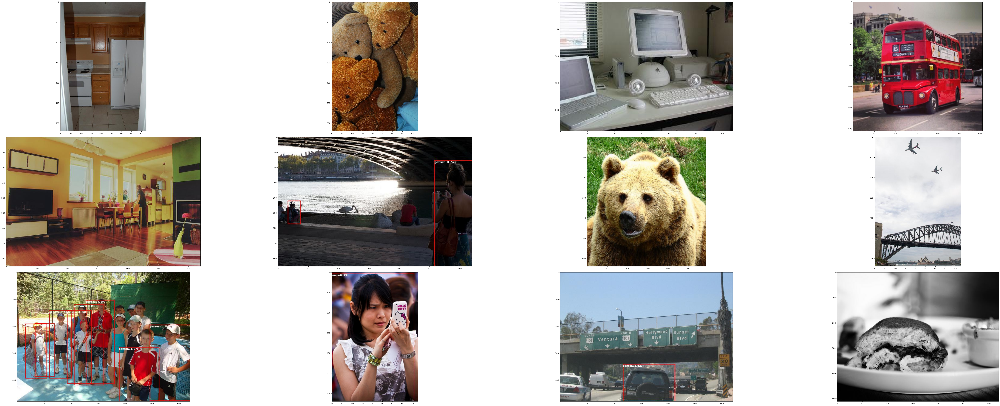

In [7]:
# Visualizing the first 12 images.
OUTPUT_PATH = 'tlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## 10. Model Export

For deployment on Infineon PSOC EDGE devices, we need to export our trained and optimized model to ONNX format. ONNX (Open Neural Network Exchange) is an open format for representing deep learning models that enables interoperability between different frameworks.

In this step, we'll export our pruned and retrained model to ONNX format using the TensorFlow-to-ONNX converter.

In [8]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_final
# Removing a pre-existing copy of the onnx if there has been any.
import os
output_file=os.path.join(os.environ['LOCAL_EXPERIMENT_DIR'],
                         "experiment_dir_final/resnet18_detector.onnx")
if os.path.exists(output_file):
    os.system("rm {}".format(output_file))
!tao model detectnet_v2 export \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/resnet18_detector_pruned.hdf5 \
                  -e $SPECS_DIR/detectnet_v2_retrain_resnet18_coco.txt \
                  -o $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector.onnx \
                  --onnx_route tf2onnx

2025-02-19 19:36:42,303 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 19:36:42,360 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 19:36:42,368 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 19:36:43.044794: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 19:36:43,082 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 19:36:44,310 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 19:36:44,342 [TAO Toolkit] [WARNING] tensorflow 42

## 11. Quantization-Aware Training (QAT)

Quantization is a technique to further reduce model size and improve inference speed by representing weights and activations with lower precision (e.g., INT8 instead of FP32). This is especially important for deployment on resource-constrained edge devices like Infineon PSOC EDGE.

While post-training quantization is simple, it often leads to accuracy degradation. Quantization-Aware Training (QAT) addresses this by simulating quantization effects during training, allowing the model to adapt to these effects and maintain accuracy.

### 11.1 Converting Pruned Model to QAT and Retraining

To enable QAT, we simply set the `enable_qat` parameter in the training configuration to `true`. This instructs the TAO toolkit to simulate quantization during the training process, resulting in a model that maintains higher accuracy when actually quantized for deployment.

Let's first examine our QAT-enabled training configuration:

In [9]:
# Printing the retrain experiment file. 
# Note: We have updated the experiment file to convert the
# pretrained model to qat mode by setting the enable_qat
# parameter.
!cat $LOCAL_SPECS_DIR/detectnet_v2_retrain_resnet18_coco_qat.txt

dataset_config {
  data_sources {
    tfrecords_path: "/workspace/tao-experiments/data/tfrecords/coco_trainval/coco_trainval-fold-001-of-002-shard-*-of-00256"
    image_directory_path: "/workspace/tao-experiments/data/raw-data"
  }
  image_extension: "jpg"
  target_class_mapping {
    key: "person"
    value: "person"
  }
  validation_data_source: {
    tfrecords_path: "/workspace/tao-experiments/data/tfrecords/coco_trainval/coco_trainval-fold-000-of-002-shard-*-of-00032"
    image_directory_path: "/workspace/tao-experiments/data/raw-data"
  }
}
augmentation_config {
  preprocessing {
    output_image_width: 320
    output_image_height: 240
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    enable_auto_resize: true
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  }
  color_augmentation {
    hue_rotation_max: 25.0
    saturation_shift_max: 0.20000000298
    contr

### 11.2 Running QAT Retraining

Next, we'll run the retraining process with QAT enabled. This will simulate the effects of quantization during training, helping the model adapt to the reduced precision.

In [10]:
!tao model detectnet_v2 train -e $SPECS_DIR/detectnet_v2_retrain_resnet18_coco_qat.txt \
                        -r $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat \
                        -n resnet18_detector_pruned_qat \
                        --gpus $NUM_GPUS

2025-02-19 19:37:31,730 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2025-02-19 19:37:31,793 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
2025-02-19 19:37:31,801 [TAO Toolkit] [INFO] nvidia_tao_cli.components.docker_handler.docker_handler 301: Printing tty value True
2025-02-19 19:37:32.524429: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2025-02-19 19:37:32,563 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2025-02-19 19:37:33,870 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2025-02-19 19:37:33,902 [TAO Toolkit] [WARNING] tensorflow 42

In [ ]:
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_retrain_qat/weights

### 11.3 Evaluating the QAT Model

After QAT retraining, we need to evaluate the model's performance to ensure that the simulated quantization hasn't significantly degraded accuracy. Ideally, the mAP of the QAT model should be comparable to that of the pruned and retrained model without QAT.

In [ ]:
!tao model detectnet_v2 evaluate -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt \
                           -m $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat/weights/resnet18_detector_pruned_qat.hdf5 \
                           -f tlt

### 11.4 Exporting the QAT Model to ONNX

Now that we have a trained and evaluated QAT model, we need to export it to ONNX format for deployment. The exported model will maintain the quantization-aware properties, making it suitable for INT8 inference.

In [ ]:
!rm -rf $LOCAL_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.onnx
!tao model detectnet_v2 export \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat/weights/resnet18_detector_pruned_qat.hdf5 \
                  -o $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.onnx \
                  -e $SPECS_DIR/detectnet_v2_retrain_resnet18_coco_qat.txt \
                  --onnx_route tf2onnx

## 12. Infineon PSOC EDGE Integration

In this final section, we'll prepare our model for deployment on Infineon PSOC EDGE devices using the Infineon Toolchain. This involves installing the necessary dependencies and using the IFX Tooling to convert our ONNX model to a format compatible with Infineon's neural processing units.

### 12.1 Installing Required Dependencies

First, we need to install the necessary packages for the Infineon toolchain:

In [ ]:
!pip install openvino_dev openvino2tensorflow tensorflow==2.8 tensorflow_datasets ethos-u-vela onnx

### 12.2 Converting the Model for Infineon PSOC EDGE

Now we'll use the Infineon Toolchain (IFX Tooling) to convert our QAT-trained ONNX model to a format compatible with Infineon PSOC EDGE devices. This process involves:

1. Specifying the path to our QAT ONNX model
2. Configuring the target hardware (Ethos-U55 neural processing unit)
3. Setting system parameters specific to the PSOC EDGE platform
4. Running the conversion process to generate deployment-ready artifacts

The configuration specifically targets the Ethos-U55-128 accelerator with the PSE84_M55_U55_400MHz system configuration, which is optimized for Infineon PSOC EDGE devices.

In [2]:
from ifx_tooling import run_ifx_tooling, ModelConversionError
import os
from pathlib import Path

qat_onnx_model_path = os.path.join(os.environ['LOCAL_EXPERIMENT_DIR'], "experiment_dir_final/resnet18_detector_qat.onnx")
ifx_tooling_output_path = os.path.join(os.environ['LOCAL_EXPERIMENT_DIR'], "ifx_tooling")

config = {
    'vela_accelerator': 'ethos-u55-128',
    'vela_system_config': 'PSE84_M55_U55_400MHz',
    'vela_memory_mode': 'Sram_Only',
    'compress_to_fp16': False,
    'vela_ini_file_path': os.path.join(os.environ['LOCAL_PROJECT_DIR'], "vela.ini")
}

try:
    output_paths = run_ifx_tooling(
        onnx_model_path=qat_onnx_model_path,
        input_shape=[1, 3, 240, 320],
        output_dir=ifx_tooling_output_path,
        config=config
    )
    print("Generated artifacts:", output_paths)
except ModelConversionError as e:
    print(f"Conversion failed: {e}")

2025-02-20 18:55:10.793880: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-02-20 18:55:10.793933: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


2025-02-20 18:55:12 | INFO     | Starting IFX tooling pipeline
2025-02-20 18:55:12 | INFO     | Input model: /teamspace/studios/this_studio/detectnet_v2/experiment_dir_final/resnet18_detector_qat.onnx
2025-02-20 18:55:12 | INFO     | Output directory: /teamspace/studios/this_studio/detectnet_v2/ifx_tooling
2025-02-20 18:55:12 | INFO     | Log file: /teamspace/studios/this_studio/detectnet_v2/ifx_tooling/logs/ifx_tooling_20250220_185512.log
2025-02-20 18:55:12 | INFO     | Configuration: {'vela_accelerator': 'ethos-u55-128', 'vela_system_config': 'PSE84_M55_U55_400MHz', 'vela_memory_mode': 'Sram_Only', 'compress_to_fp16': False, 'vela_ini_file_path': '/teamspace/studios/this_studio/vela.ini'}
2025-02-20 18:55:12 | INFO     | 🔄 Processing ONNX model...
2025-02-20 18:55:12 | INFO     | ✅ ONNX processing complete. Output: /teamspace/studios/this_studio/detectnet_v2/ifx_tooling/processed_onnx/resnet18_detector_qat_processed.onnx
2025-02-20 18:55:12 | INFO     | 🔄 Converting to OpenVINO form

2025-02-20 18:55:33.591695: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2025-02-20 18:55:33.591735: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2025-02-20 18:55:33.591752: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (ip-10-192-12-12): /proc/driver/nvidia/version does not exist
2025-02-20 18:55:33.591950: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-02-20 18:55:35.176641: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:357

Estimated count of arithmetic ops: 3.633 G  ops, equivalently 1.816 G  MACs
Estimated count of arithmetic ops: 3.633 G  ops, equivalently 1.816 G  MACs
2025-02-20 18:55:49 | INFO     | ✅ TFLite conversion complete. Output: /teamspace/studios/this_studio/detectnet_v2/ifx_tooling/resnet18_detector_qat.tflite
2025-02-20 18:55:49 | INFO     | 🔄 Running Vela compiler...


fully_quantize: 0, inference_type: 6, input_inference_type: 9, output_inference_type: 9
2025-02-20 18:55:49.098586: I tensorflow/compiler/mlir/lite/flatbuffer_export.cc:1963] Estimated count of arithmetic ops: 3.633 G  ops, equivalently 1.816 G  MACs



2025-02-20 18:55:52 | INFO     | ✅ Vela compilation complete
2025-02-20 18:55:52 | INFO     | 📝 Vela output saved at: /teamspace/studios/this_studio/detectnet_v2/ifx_tooling/model_vela/vela_output.txt
2025-02-20 18:55:52 | INFO     | 🔍 Verifying outputs...
2025-02-20 18:55:52 | INFO     | ✨ Model conversion pipeline completed successfully
Generated artifacts: {'onnx_processed': PosixPath('/teamspace/studios/this_studio/detectnet_v2/ifx_tooling/processed_onnx/resnet18_detector_qat_processed.onnx'), 'openvino': PosixPath('/teamspace/studios/this_studio/detectnet_v2/ifx_tooling/model_openvino'), 'tensorflow': PosixPath('/teamspace/studios/this_studio/detectnet_v2/ifx_tooling/model_tf'), 'tflite': PosixPath('/teamspace/studios/this_studio/detectnet_v2/ifx_tooling/resnet18_detector_qat.tflite'), 'vela': PosixPath('/teamspace/studios/this_studio/detectnet_v2/ifx_tooling/model_vela'), 'vela_config': PosixPath('/teamspace/studios/this_studio/detectnet_v2/ifx_tooling/vela.ini')}


## 13. Conclusion and Next Steps

Congratulations! You have successfully:

1. **Trained** a ResNet-18 based DetectNet_v2 model on the COCO dataset
2. **Evaluated** the model to establish a performance baseline
3. **Pruned** the model to reduce its size and computational requirements
4. **Retrained** the pruned model to recover accuracy
5. **Applied Quantization-Aware Training** to prepare the model for efficient INT8 inference
6. **Exported** the optimized model to ONNX format
7. **Converted** the model for deployment on Infineon PSOC EDGE devices using the Infineon Toolchain

### Next Steps

To deploy this model on your Infineon PSOC EDGE device:

1. Transfer the generated artifacts from the `ifx_tooling` directory to your development environment
2. Use the Infineon ModusToolbox™ to integrate the model into your application
3. Implement the pre-processing and post-processing logic to handle inputs and outputs
4. Test and validate the deployment on your target hardware

### Further Optimization Possibilities

If you need additional performance improvements:

1. **Data Augmentation**: Enhance the training dataset with more varied examples
2. **Hyperparameter Tuning**: Fine-tune learning rates, batch sizes, and other parameters
3. **Model Architecture**: Consider alternative model architectures like MobileNet for even more efficiency
4. **Custom Dataset**: Train on a dataset specific to your application domain

This workflow provides a strong foundation for developing and deploying efficient AI models on Infineon PSOC EDGE devices, enabling you to bring intelligence to the edge with optimized performance and resource usage.